modified keras UNET based on pix to pix generator 2nd varient, descriminator is custom without dilation

#### tensorflow_examples package used to  import of the generator and the discriminator availabel in tensorflow package. This was used to just understand the code available.

In [1]:
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to c:\users\navee\appdata\local\temp\pip-req-build-hc9fbl3j
  Resolved https://github.com/tensorflow/examples.git to commit 3df76a9e45e3a1d6165e42c565a2f8622f7c1f8c
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for tensorflow-examples: filename=tensorflow_examples-3df76a9e45e3a1d6165e42c565a2f8622f7c1f8c_-py3-none-any.whl size=301884 sha256=83003b5b0e4586e99157fa183901deb744a3b1100d956b9d72196121bdec0441
  Stored in directory: C:\Users\navee\AppData\Local\Temp\pip-ephem-wheel-cache-igasctas\wheels\4e\f5\c2\bfe75b834c9028b2529023bf74541c46ead531b513a8010d21
Failed to build tensorflow-examples
  Attempting uninstall: tensorflow-examples
    Found existing installation: tensorflow-examples 4837a91a2503881396b1d4287e8bd79f85331a8e-
    Uninstalling tensorflow-examples-4837a91a2503881396b1d4287e8bd79f85331a8e-:
      Successfully uninstalled tensorflow-examples-4837a9

  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/examples.git 'C:\Users\navee\AppData\Local\Temp\pip-req-build-hc9fbl3j'
  DEPRECATION: tensorflow-examples was installed using the legacy 'setup.py install' method, because a wheel could not be built for it. pip 23.1 will enforce this behaviour change. A possible replacement is to fix the wheel build issue reported above. Discussion can be found at https://github.com/pypa/pip/issues/8368


In [2]:
import tensorflow as tf

In [3]:
import tensorflow_datasets as tfds
from tensorflow_examples.models.pix2pix import pix2pix


import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output

AUTOTUNE = tf.data.AUTOTUNE

C:\Users\navee\anaconda3\envs\testing\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Load horses and zebra dataset from tensorflow dataset

In [4]:
dataset, metadata = tfds.load('cycle_gan/horse2zebra',
                              with_info=True, as_supervised=True)

train_horses, train_zebras = dataset['trainA'], dataset['trainB']
test_horses, test_zebras = dataset['testA'], dataset['testB']


In [5]:
print(len(train_horses))
print(len(train_zebras))
print(len(test_horses))
print(len(test_zebras))

1067
1334
120
140


In [6]:
BUFFER_SIZE = 1000
BATCH_SIZE = 3
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [7]:
def random_crop(image):
  cropped_image = tf.image.random_crop(
      image, size=[IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image

In [8]:

def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

In [9]:
def random_apply(image):

  image = tf.image.resize(image, [286, 286],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  image = random_crop(image)

  image = tf.image.random_flip_left_right(image)

  return image

In [10]:
def preprocess_image_train(image, label):
  image = random_apply(image)
  image = normalize(image)
  return image

In [11]:
def preprocess_image_test(image, label):
  image = normalize(image)
  return image

In [12]:
train_horses = train_horses.cache().map(
    preprocess_image_train, num_parallel_calls=AUTOTUNE).shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

train_zebras = train_zebras.cache().map(
    preprocess_image_train, num_parallel_calls=AUTOTUNE).shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

test_horses = test_horses.map(
    preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

test_zebras = test_zebras.map(
    preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

In [13]:
sample_horse = next(iter(train_horses))
sample_zebra = next(iter(train_zebras))

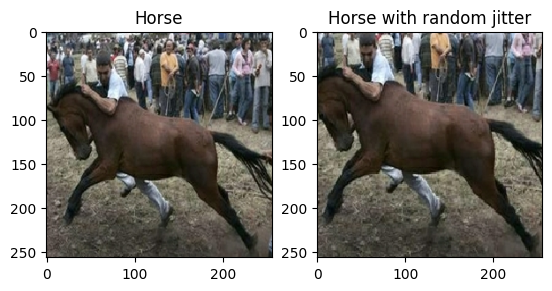

In [14]:
plt.subplot(121)
plt.title('Horse')
plt.imshow(sample_horse[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Horse with random jitter')
plt.imshow(random_apply(sample_horse[0]) * 0.5 + 0.5)


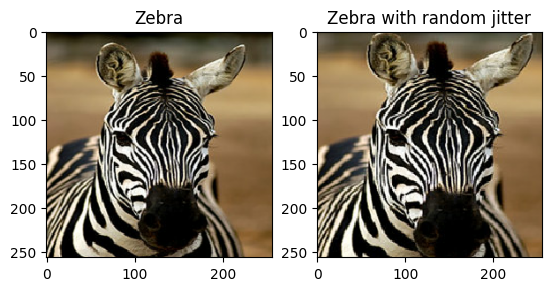

In [15]:
plt.subplot(121)
plt.title('Zebra')
plt.imshow(sample_zebra[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Zebra with random jitter')
plt.imshow(random_apply(sample_zebra[0]) * 0.5 + 0.5)

In [16]:

from custom import custom_unet_generator_v3,custom_unet_descriminator_v2
generator_g = custom_unet_generator_v3()
generator_f = custom_unet_generator_v3()
print(generator_g.summary())

discriminator_x = custom_unet_descriminator_v2(target=False)
discriminator_y = custom_unet_descriminator_v2(target=False)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 40) 1080        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 40) 14400       conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 128, 128, 80) 28800       conv2d_1[0][0]                   
______________________________________________________________________________________________

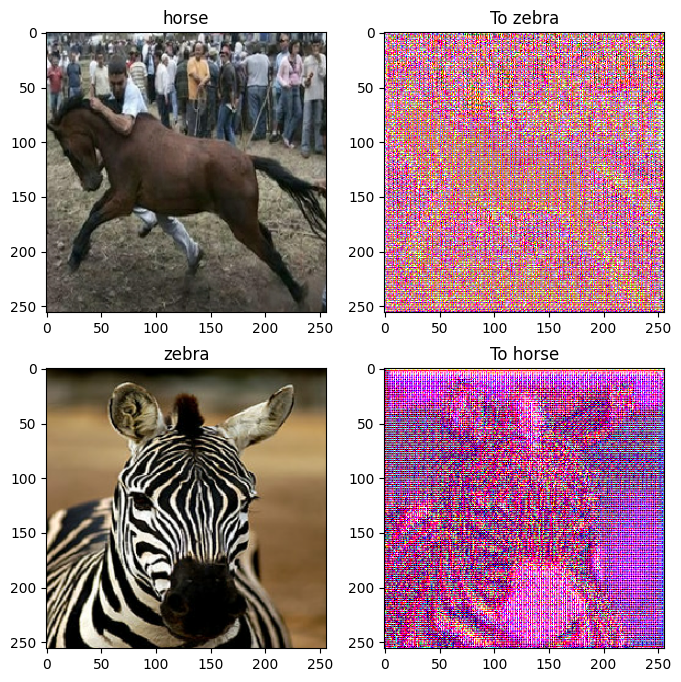

In [17]:
to_zebra = generator_g(sample_horse)
to_horse = generator_f(sample_zebra)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_horse, to_zebra, sample_zebra, to_horse]
title = ['horse', 'To zebra', 'zebra', 'To horse']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i][0] * 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()

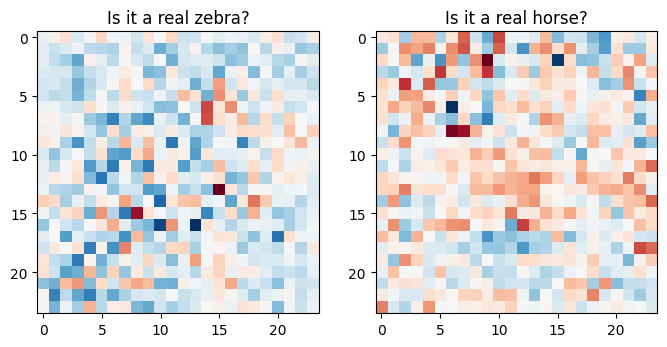

In [18]:
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is it a real zebra?')
plt.imshow(discriminator_y(sample_zebra)[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Is it a real horse?')
plt.imshow(discriminator_x(sample_horse)[0, ..., -1], cmap='RdBu_r')

plt.show()

## Loss functions

In [19]:
LAMBDA = 10

In [20]:
binary_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [21]:
def discriminator_loss(real, generated):
  real_loss = binary_loss(tf.ones_like(real), real)

  generated_loss = binary_loss(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

In [22]:
def generator_loss(generated):
  return binary_loss(tf.ones_like(generated), generated)

In [23]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  
  return LAMBDA * loss1

In [24]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

In [25]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Checkpoints

In [26]:
checkpoint_path = "./checkpoints/train"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=50)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


In [27]:
EPOCHS = 40

In [28]:
def generate_images(model, test_input):
  prediction = model(test_input)
    
  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])

    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [29]:

import numpy



@tf.function
def train_step(real_x, real_y):

  with tf.GradientTape(persistent=True) as tape:

    
    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)


    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)


    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)
    
    l1=calc_cycle_loss(real_x, cycled_x)
    l2=calc_cycle_loss(real_y, cycled_y)
    
    total_cycle_loss = l1 + l2
    
 
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)
  
 
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))
  
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))
  
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))
  return l1,l2,total_cycle_loss

....................................356
356
356


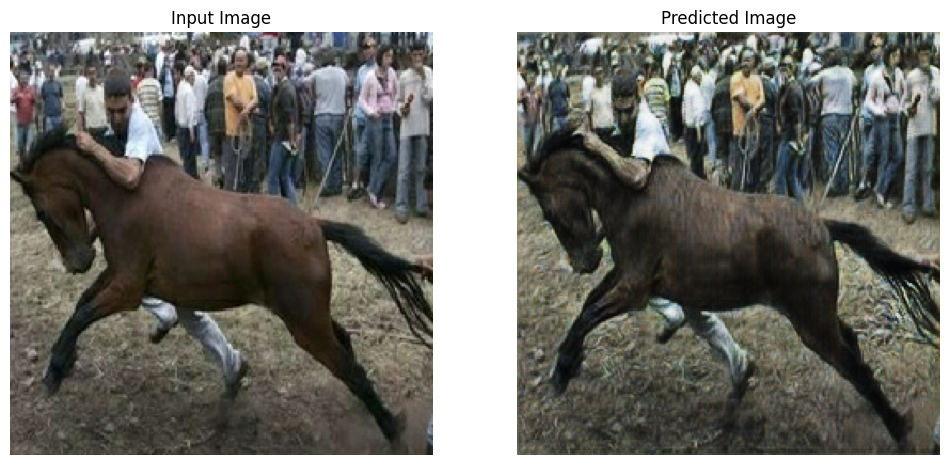

Time taken for epoch 1 is 133.63576221466064 sec

....................................356
356
356


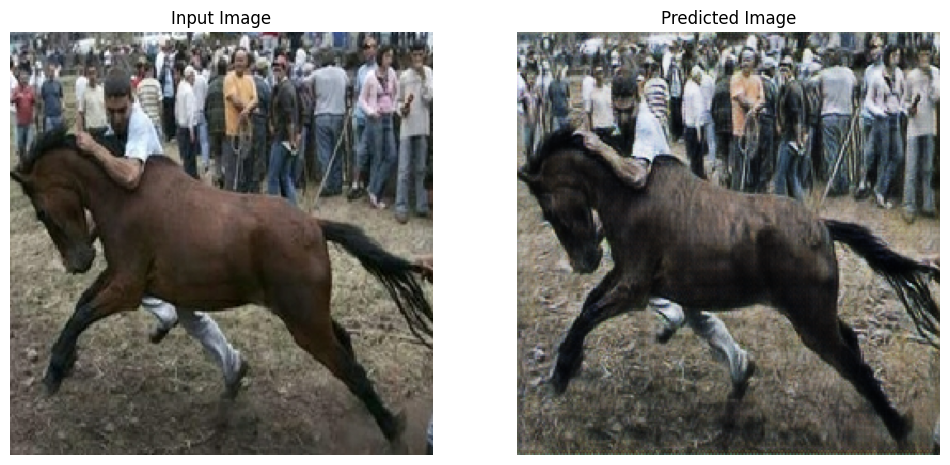

Time taken for epoch 2 is 108.76629519462585 sec

....................................356
356
356


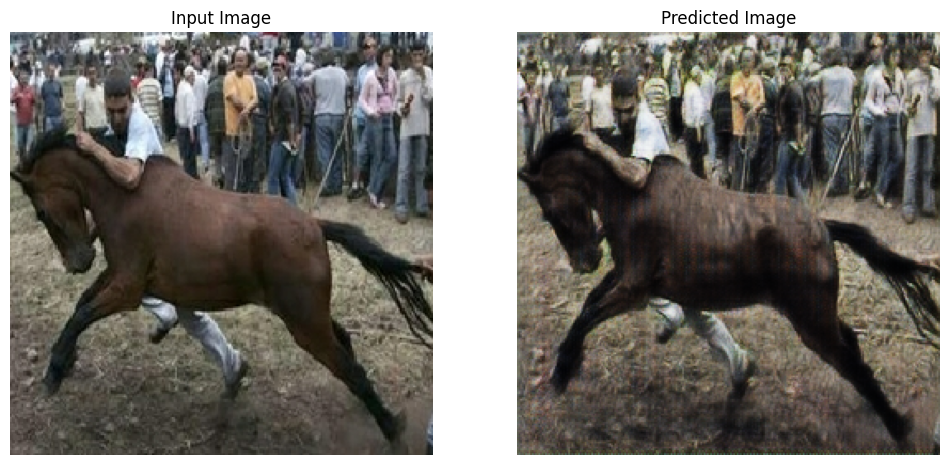

Time taken for epoch 3 is 110.10851860046387 sec

....................................356
356
356


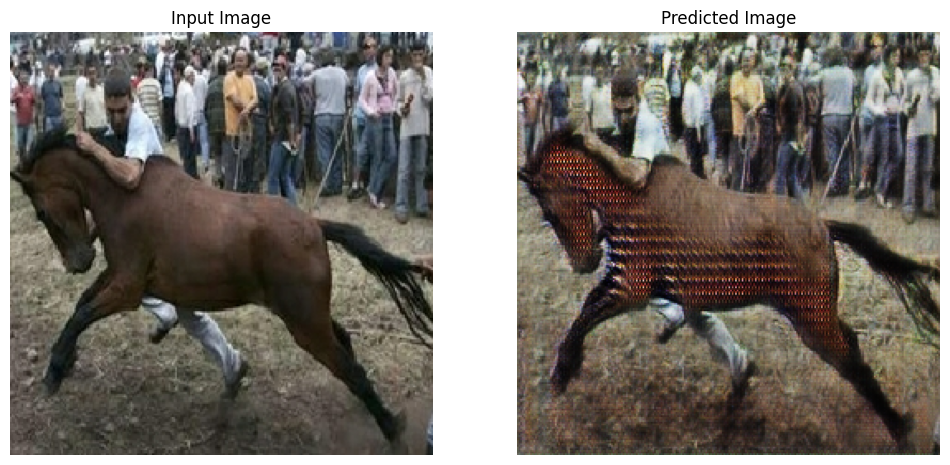

Time taken for epoch 4 is 110.5194616317749 sec

....................................356
356
356


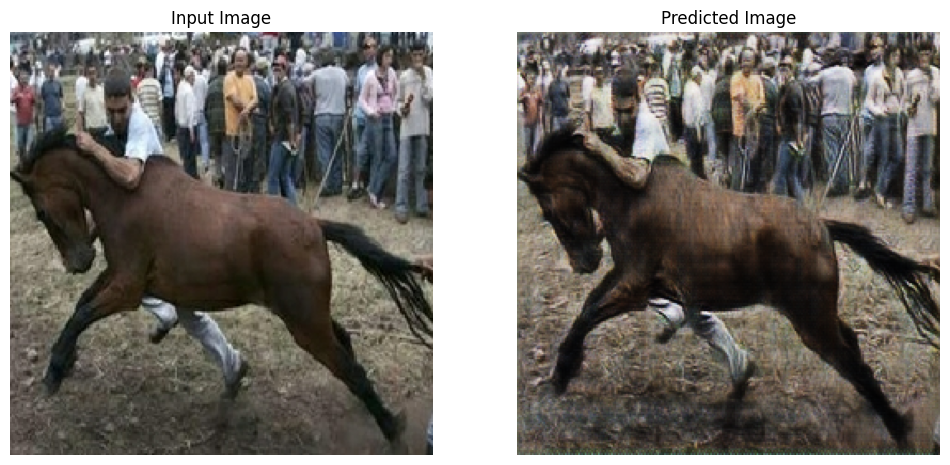

Saving checkpoint for epoch 5 at ./checkpoints/train\ckpt-15
Time taken for epoch 5 is 115.03825211524963 sec

....................................356
356
356


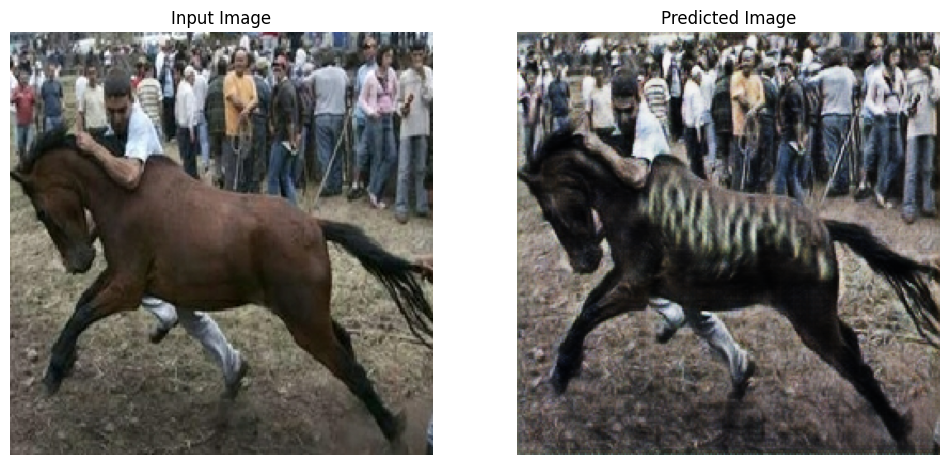

Time taken for epoch 6 is 111.56271576881409 sec

....................................356
356
356


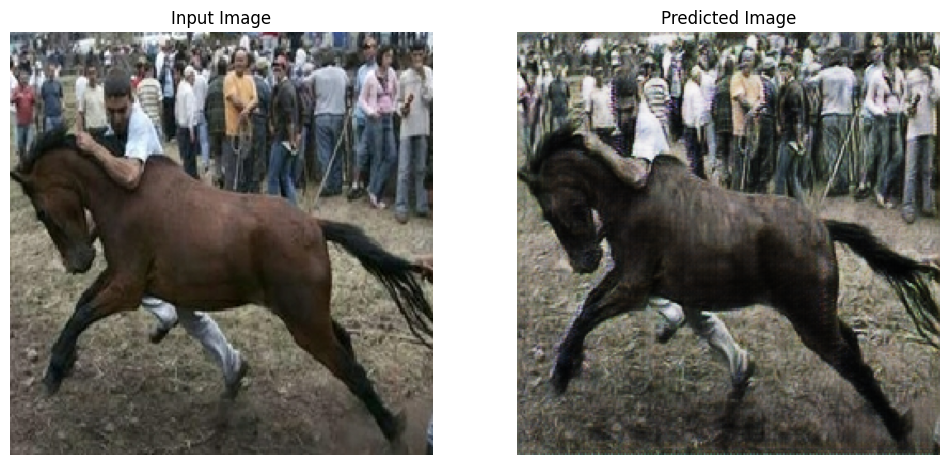

Time taken for epoch 7 is 112.25581121444702 sec

....................................356
356
356


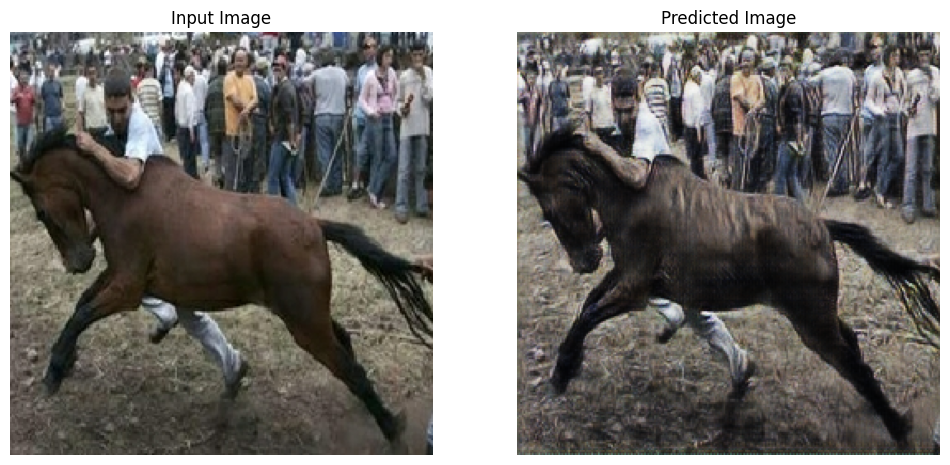

Time taken for epoch 8 is 112.1543505191803 sec

....................................356
356
356


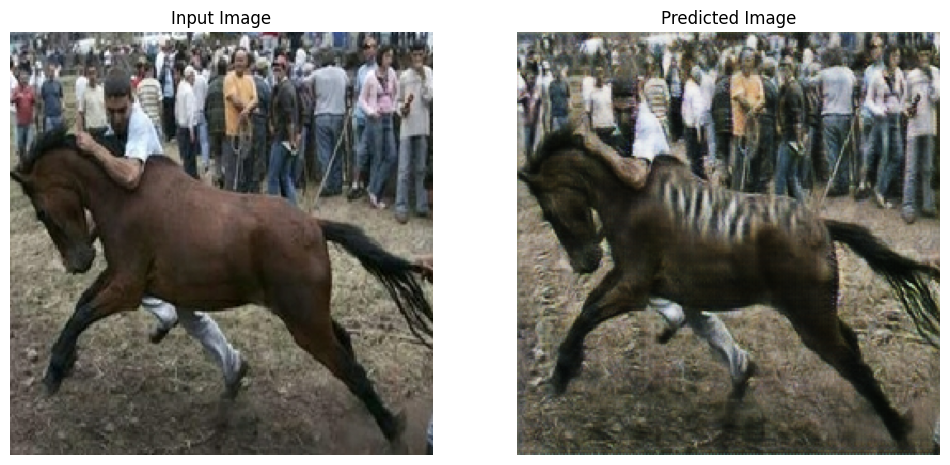

Time taken for epoch 9 is 110.68379402160645 sec

....................................356
356
356


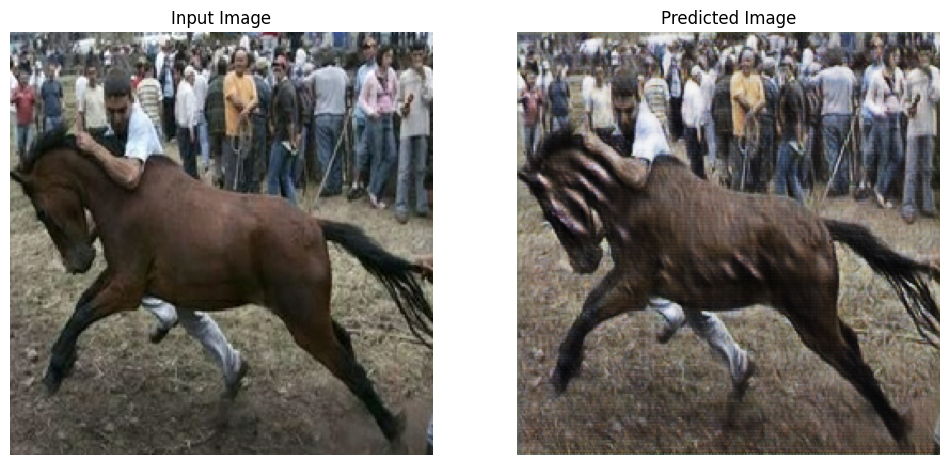

Saving checkpoint for epoch 10 at ./checkpoints/train\ckpt-16
Time taken for epoch 10 is 113.21899008750916 sec

....................................356
356
356


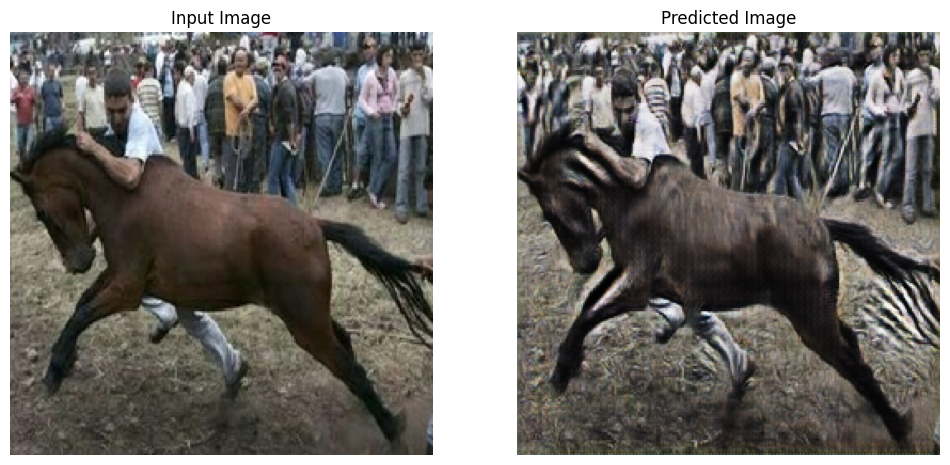

Time taken for epoch 11 is 109.74463558197021 sec

....................................356
356
356


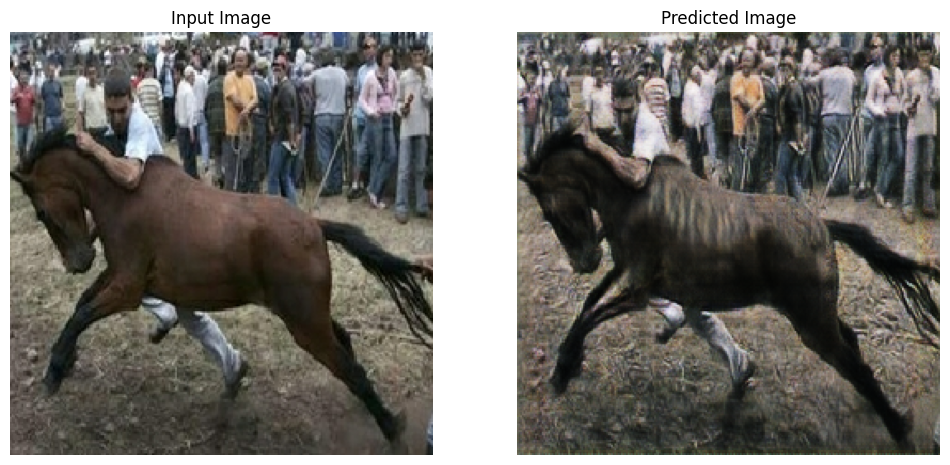

Time taken for epoch 12 is 109.52525186538696 sec

....................................356
356
356


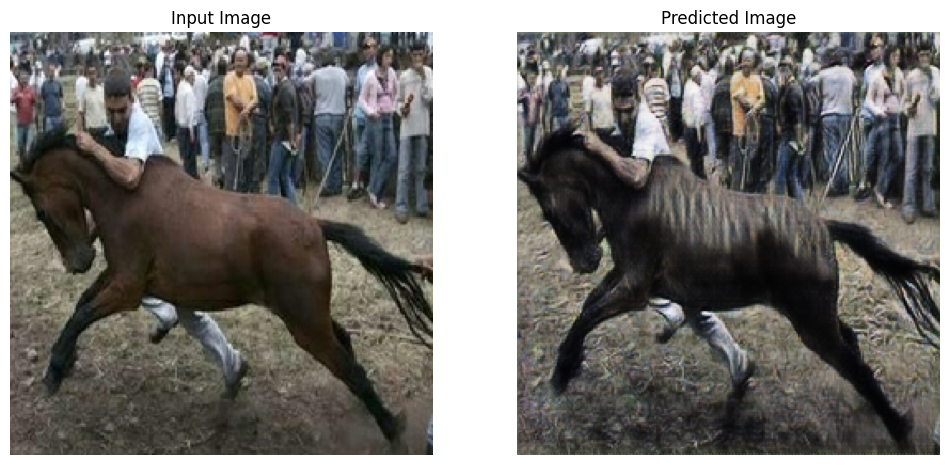

Time taken for epoch 13 is 110.16763973236084 sec

....................................356
356
356


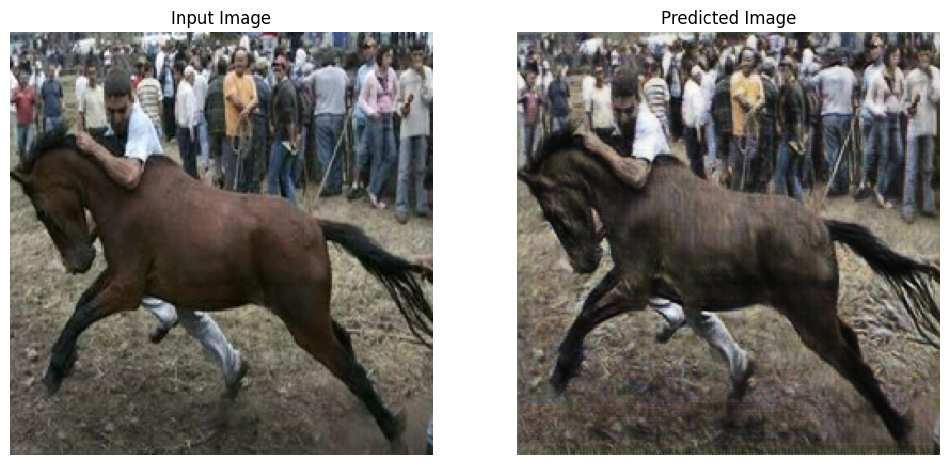

Time taken for epoch 14 is 110.64939165115356 sec

....................................356
356
356


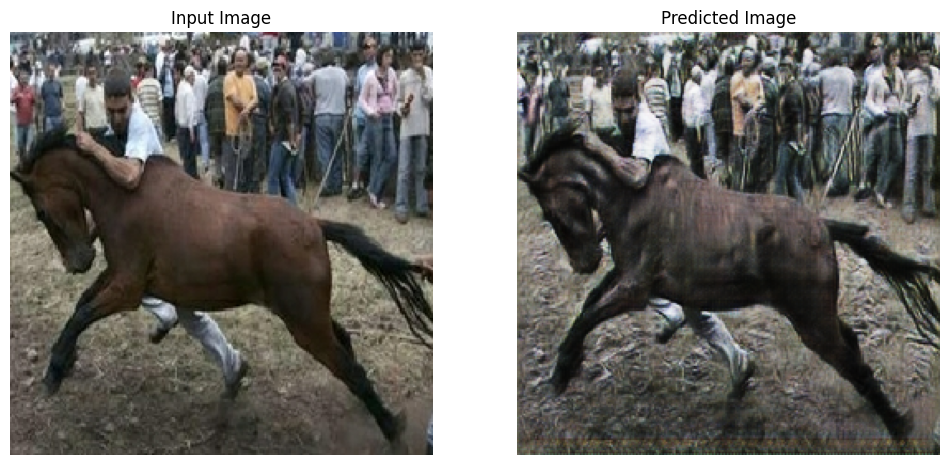

Saving checkpoint for epoch 15 at ./checkpoints/train\ckpt-17
Time taken for epoch 15 is 114.10768222808838 sec

....................................356
356
356


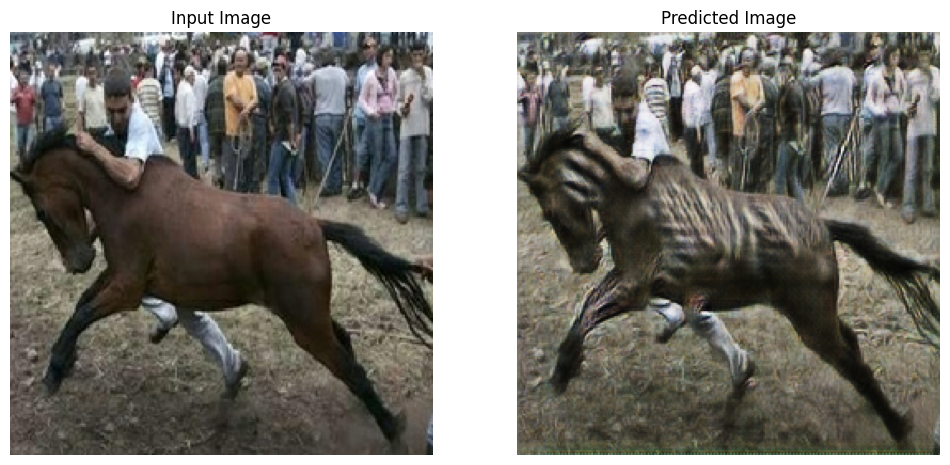

Time taken for epoch 16 is 110.0112714767456 sec

....................................356
356
356


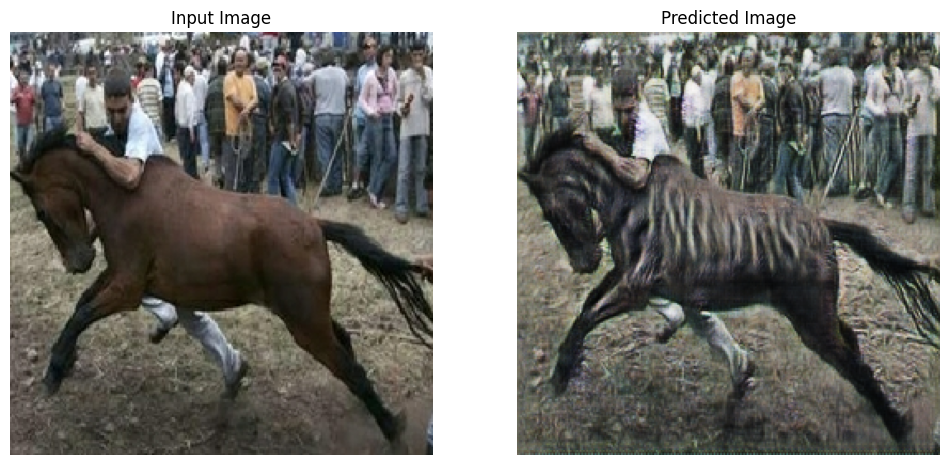

Time taken for epoch 17 is 109.501882314682 sec

....................................356
356
356


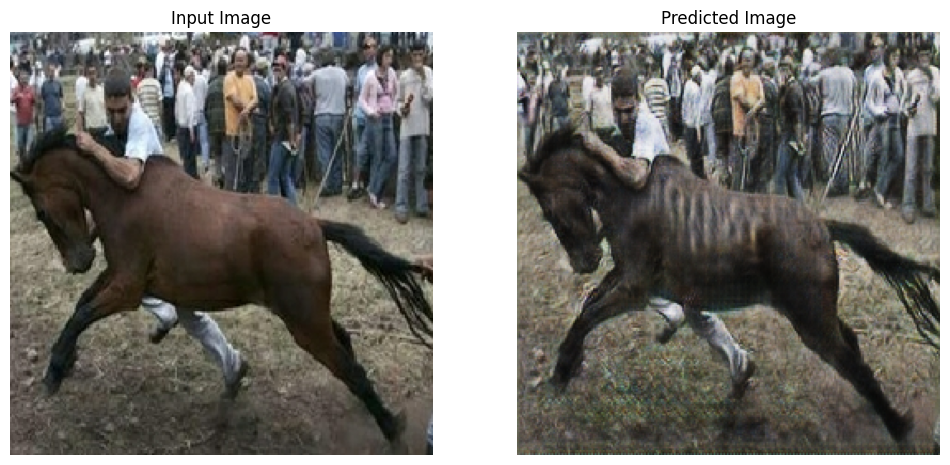

Time taken for epoch 18 is 109.99784350395203 sec

....................................356
356
356


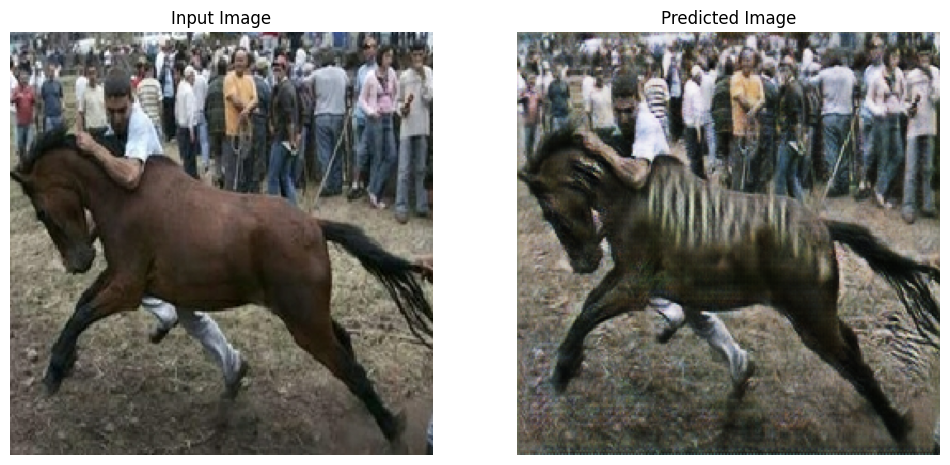

Time taken for epoch 19 is 110.22276616096497 sec

....................................356
356
356


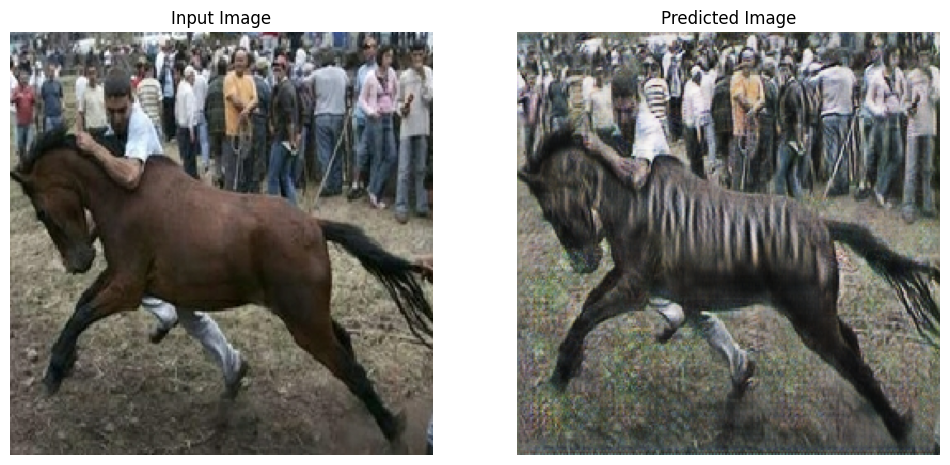

Saving checkpoint for epoch 20 at ./checkpoints/train\ckpt-18
Time taken for epoch 20 is 130.0591220855713 sec

....................................356
356
356


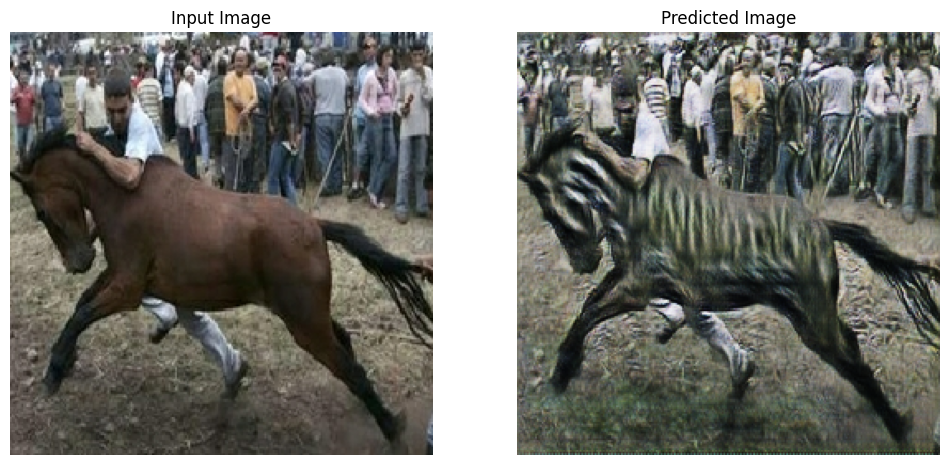

Time taken for epoch 21 is 117.56722474098206 sec

....................................356
356
356


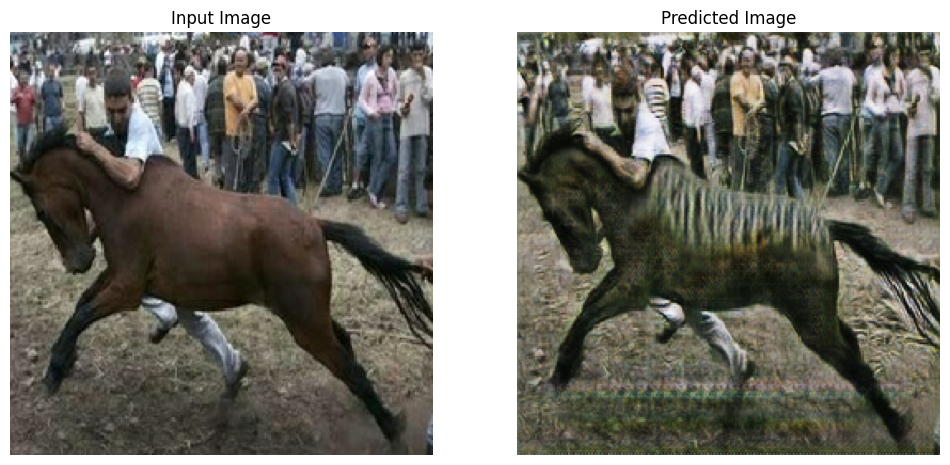

Time taken for epoch 22 is 118.89067769050598 sec

....................................356
356
356


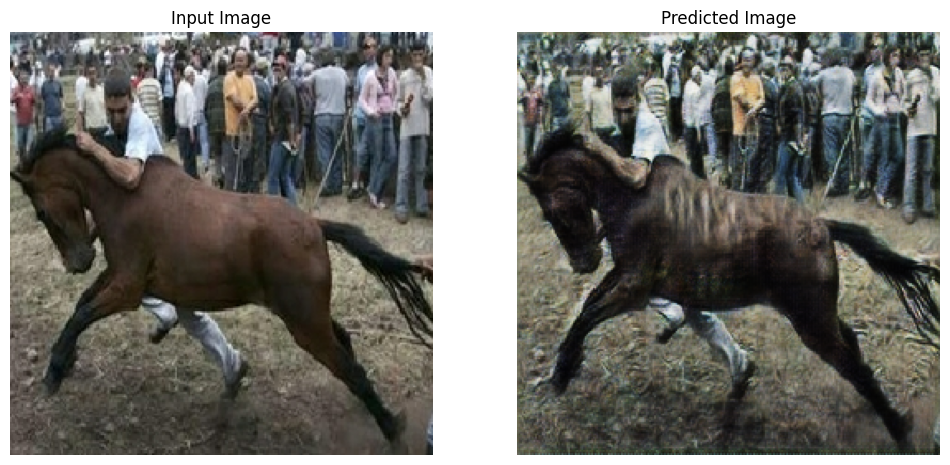

Time taken for epoch 23 is 121.4218499660492 sec

....................................356
356
356


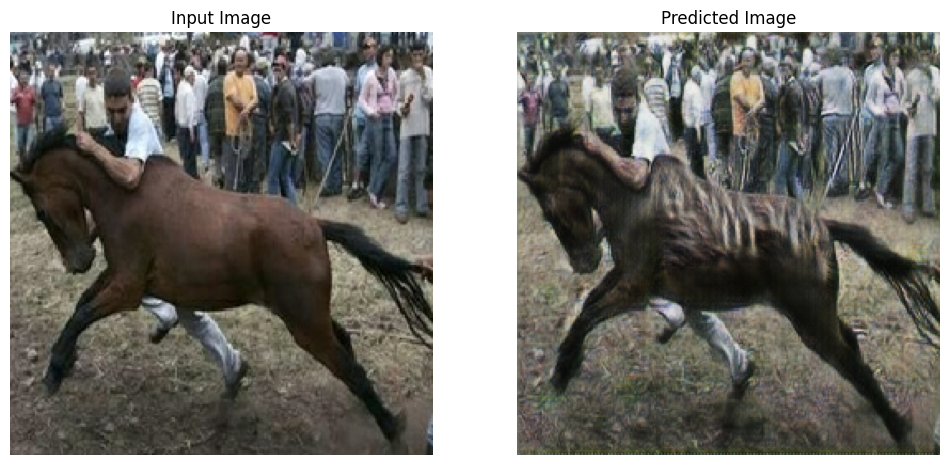

Time taken for epoch 24 is 118.4798481464386 sec

....................................356
356
356


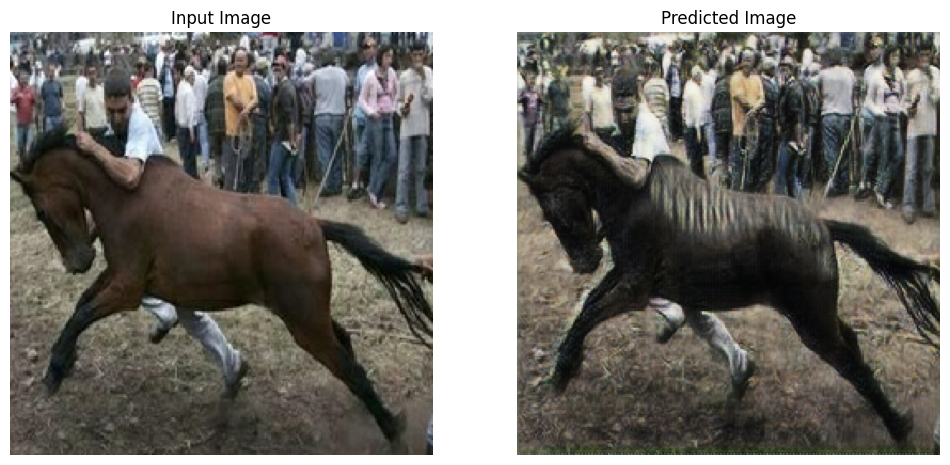

Saving checkpoint for epoch 25 at ./checkpoints/train\ckpt-19
Time taken for epoch 25 is 120.19338011741638 sec

....................................356
356
356


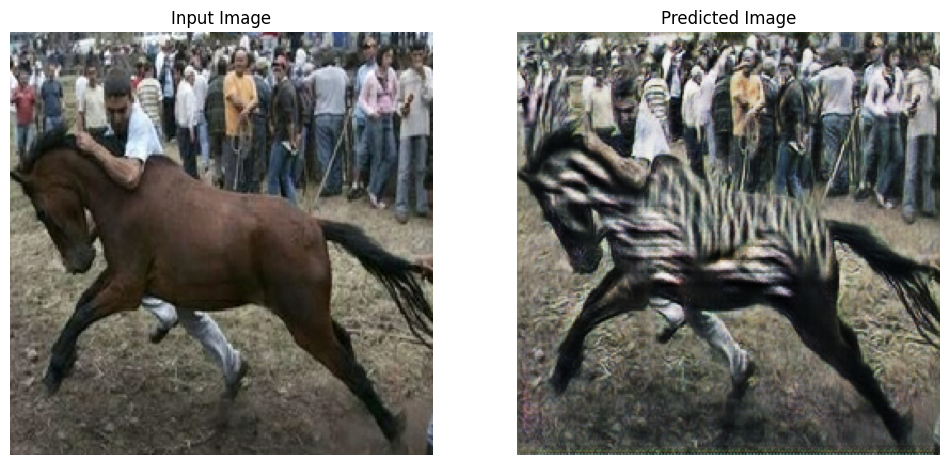

Time taken for epoch 26 is 120.41456985473633 sec

....................................356
356
356


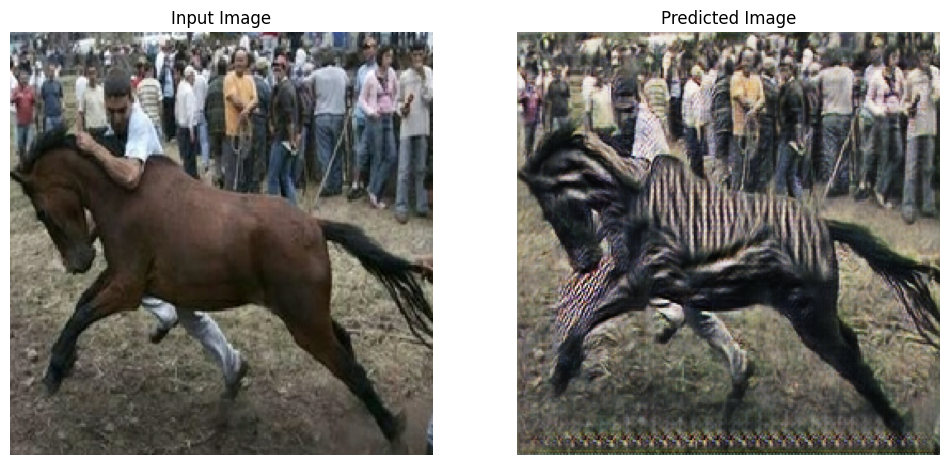

Time taken for epoch 27 is 120.20926570892334 sec

....................................356
356
356


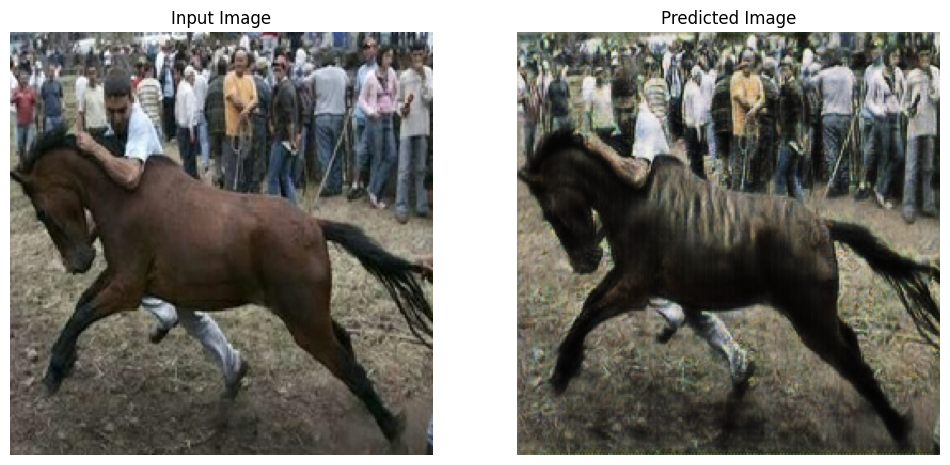

Time taken for epoch 28 is 126.30914735794067 sec

....................................356
356
356


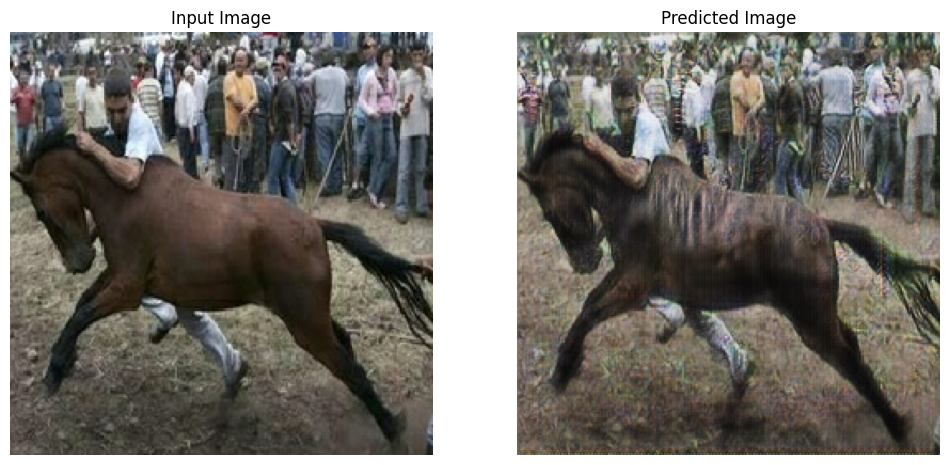

Time taken for epoch 29 is 118.60666823387146 sec

....................................356
356
356


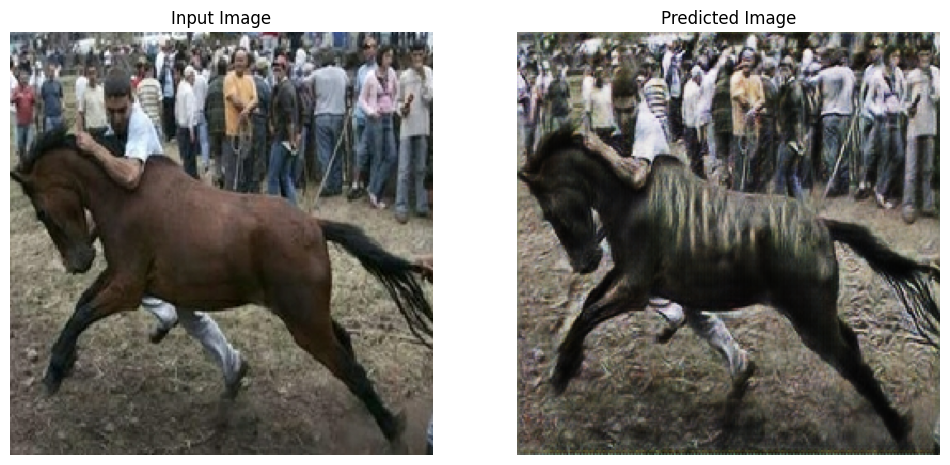

Saving checkpoint for epoch 30 at ./checkpoints/train\ckpt-20
Time taken for epoch 30 is 135.20570945739746 sec

....................................356
356
356


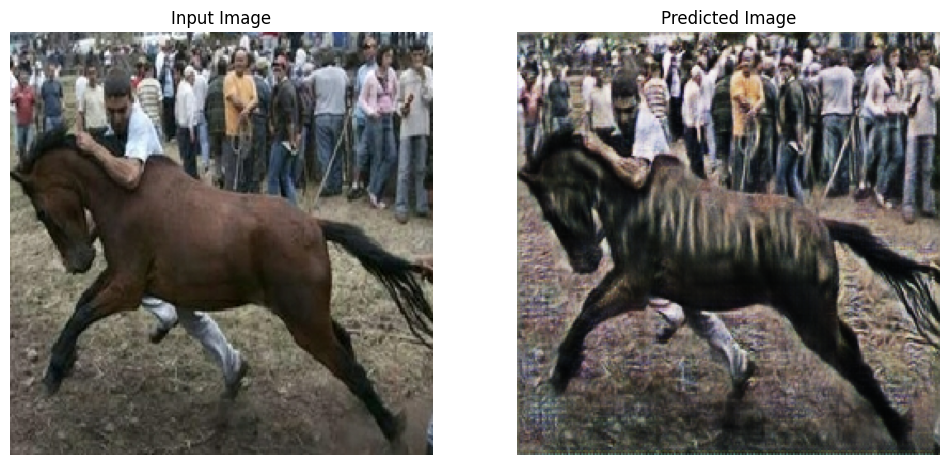

Time taken for epoch 31 is 122.99757075309753 sec

....................................356
356
356


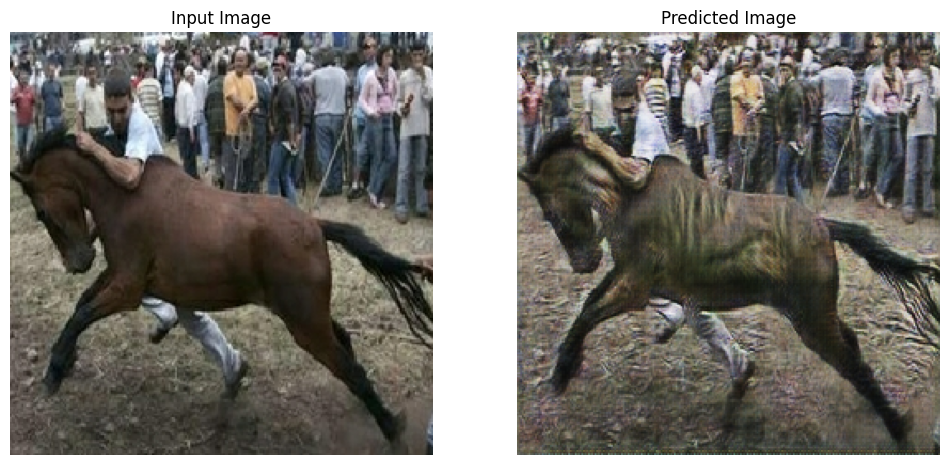

Time taken for epoch 32 is 117.42779040336609 sec

....................................356
356
356


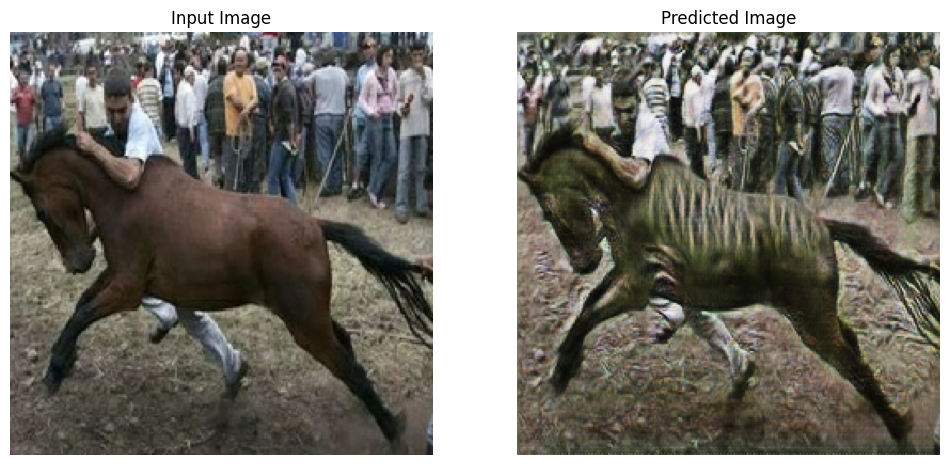

Time taken for epoch 33 is 109.93256664276123 sec

....................................356
356
356


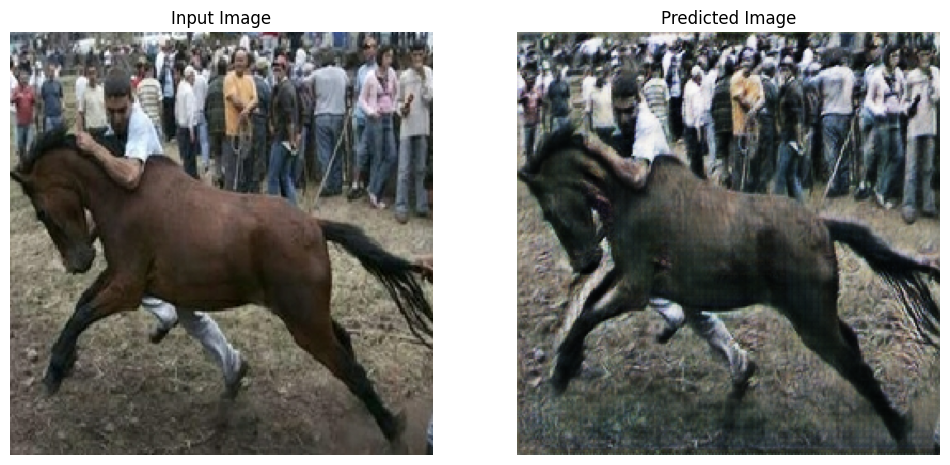

Time taken for epoch 34 is 109.75910186767578 sec

....................................356
356
356


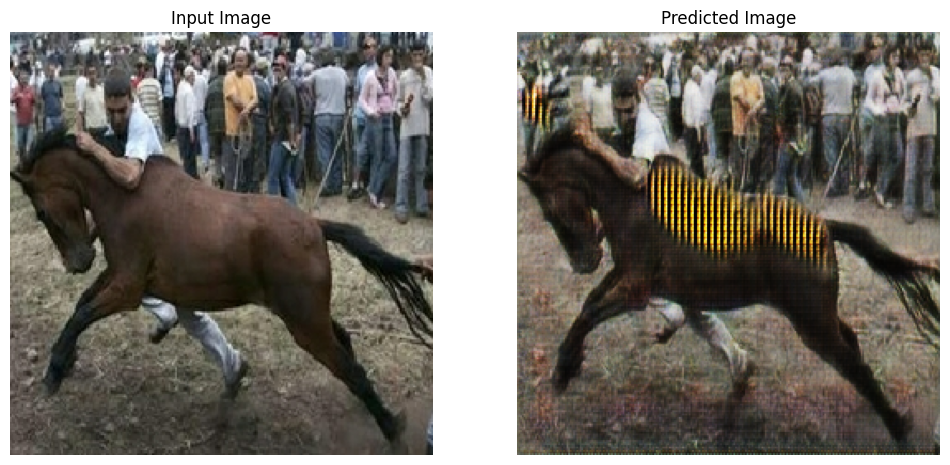

Saving checkpoint for epoch 35 at ./checkpoints/train\ckpt-21
Time taken for epoch 35 is 113.6218650341034 sec

....................................356
356
356


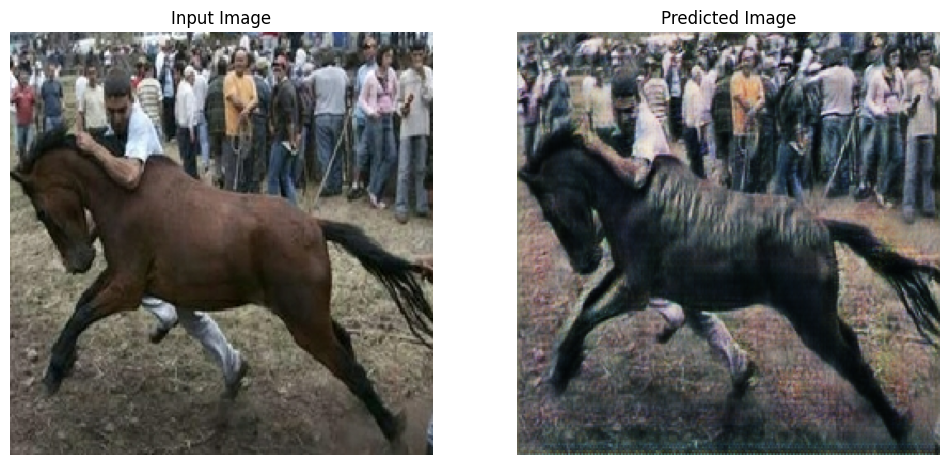

Time taken for epoch 36 is 110.77435660362244 sec

....................................356
356
356


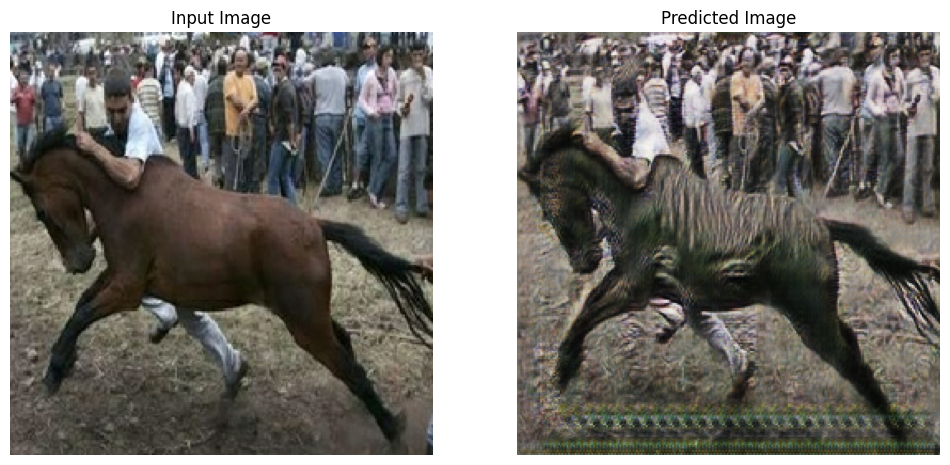

Time taken for epoch 37 is 110.1003987789154 sec

....................................356
356
356


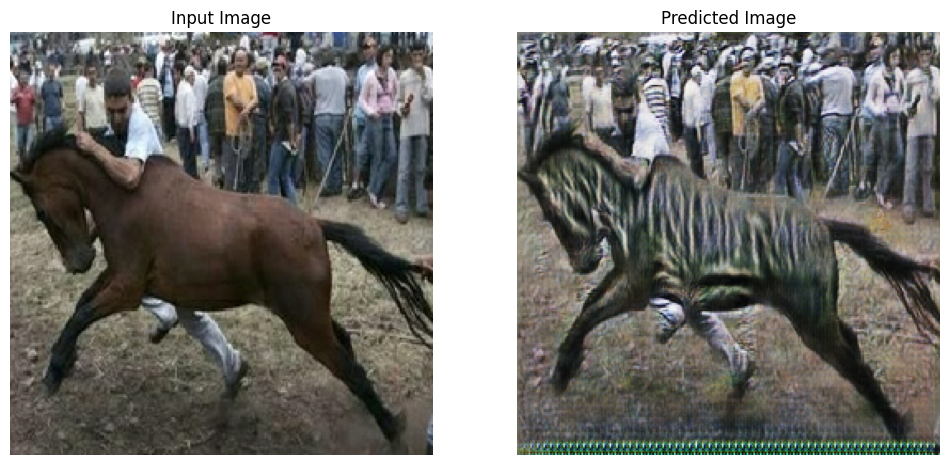

Time taken for epoch 38 is 109.82237410545349 sec

....................................356
356
356


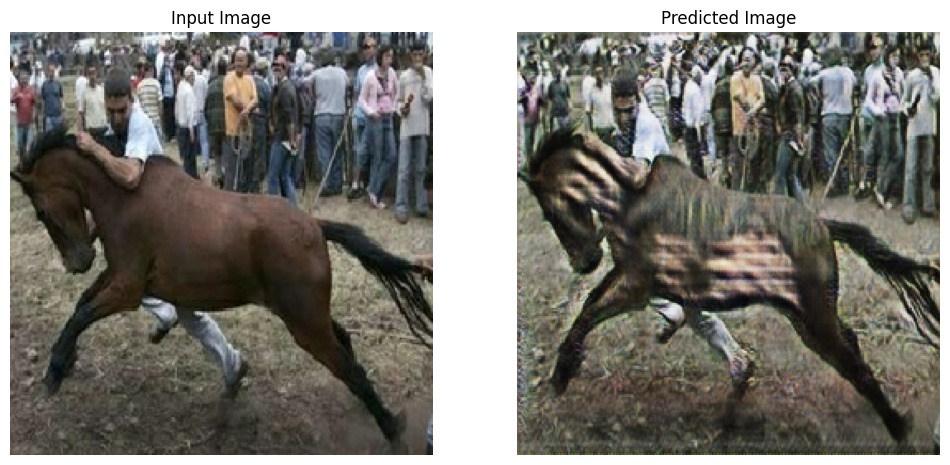

Time taken for epoch 39 is 109.66007876396179 sec

....................................356
356
356


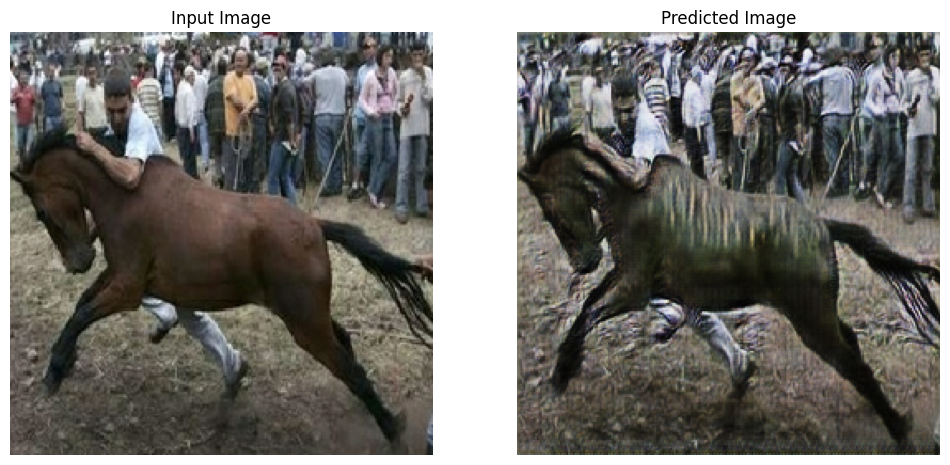

Saving checkpoint for epoch 40 at ./checkpoints/train\ckpt-22
Time taken for epoch 40 is 112.65563321113586 sec



In [30]:
l1_loss=[]
l2_loss=[]
total_cycle_loss_loss=[]
import numpy as np

for epoch in range(EPOCHS):
  start = time.time()
  aa=[]
  bb=[]
  cc=[]

  n = 0
  for image_x, image_y in tf.data.Dataset.zip((train_horses, train_zebras)):
    l1,l2,total_cycle_loss=train_step(image_x, image_y)
    
    aa.append(l1)
    bb.append(l2)
    cc.append(total_cycle_loss)
    
    if n % 10 == 0:
      print ('.', end='')
    n += 1
  aaa = [tensor.numpy() for tensor in aa]
  bbb = [tensor.numpy() for tensor in bb]
  ccc = [tensor.numpy() for tensor in cc]
  aaa = np.array(aaa)
  bbb = np.array(bbb)
  ccc = np.array(ccc)
  print(len(aaa))
  print(len(bbb))
  print(len(ccc))

  l1_loss.append(np.mean(aaa))
  l2_loss.append(np.mean(bbb))
  total_cycle_loss_loss.append(np.mean(ccc))
    

  generate_images(generator_g, sample_horse)

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))

In [31]:
# ckpt_save_path = ckpt_manager.save()

## Generate using test dataset

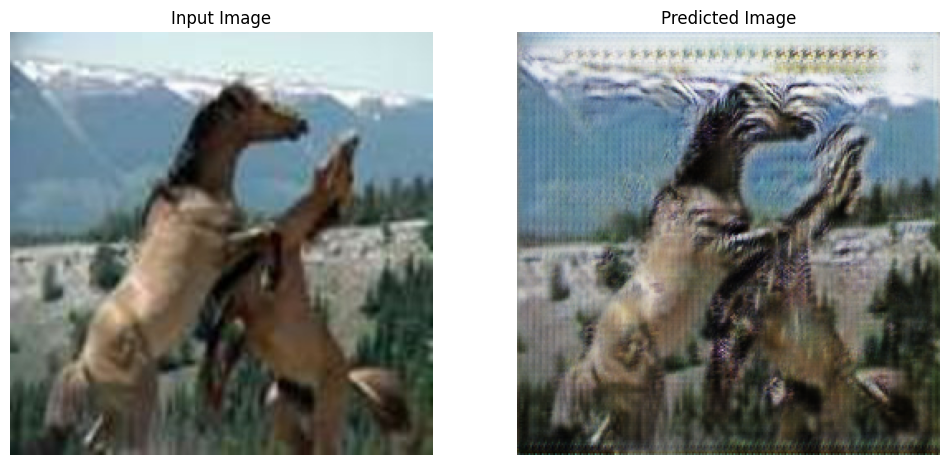

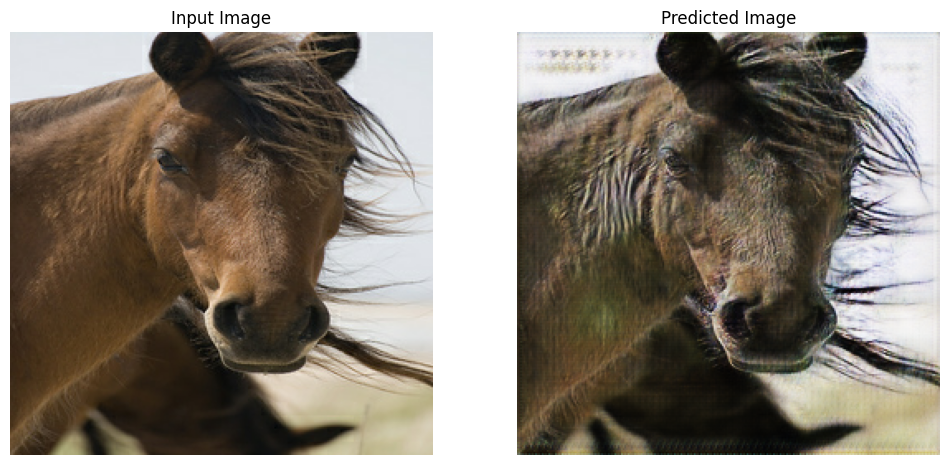

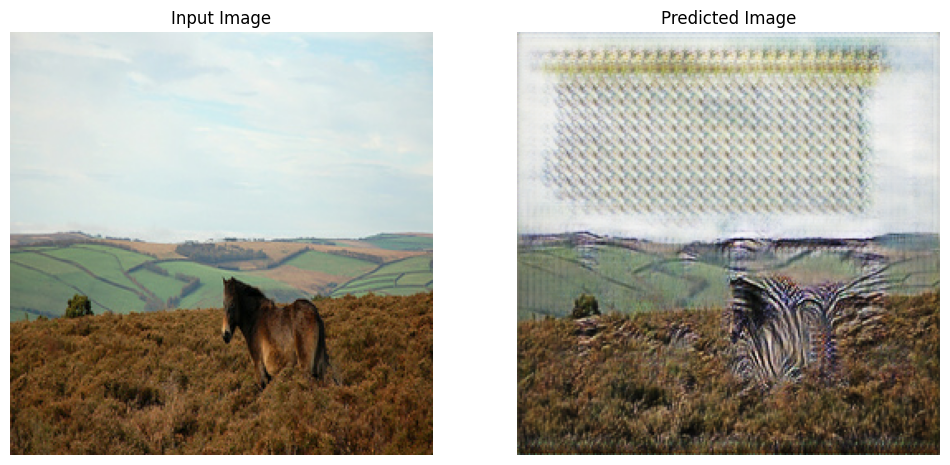

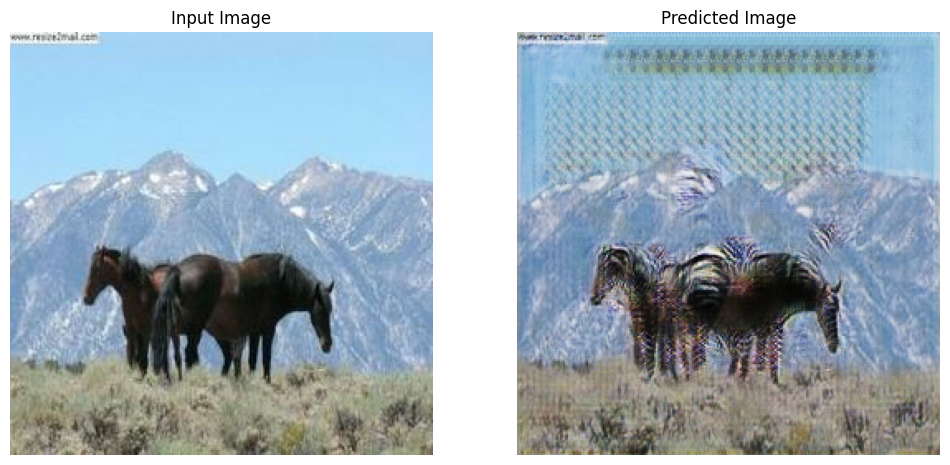

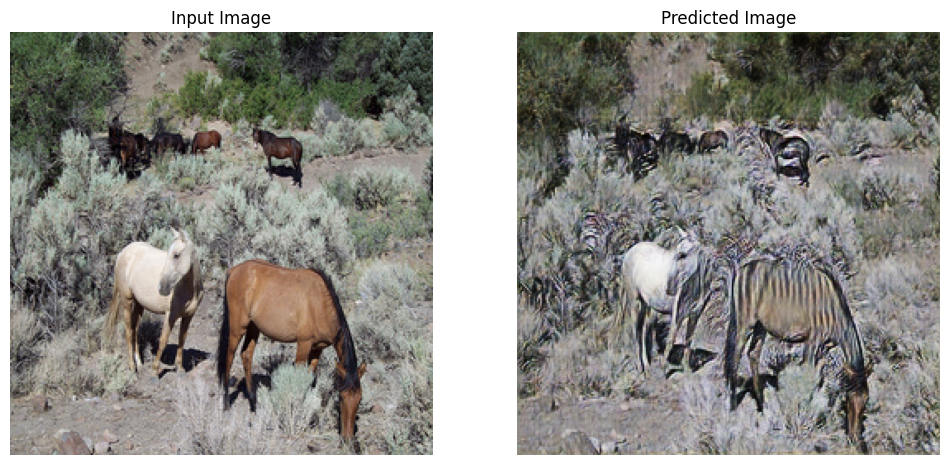

In [32]:

for inp in test_horses.take(5):
  generate_images(generator_g, inp)

In [33]:
print(len(l1_loss))

40


In [34]:
yy=np.arange(len(l1_loss))

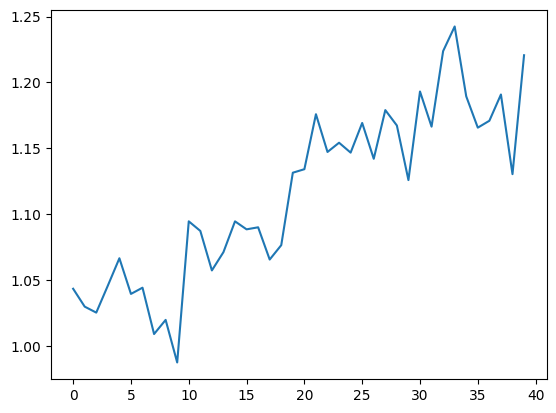

In [35]:
plt.plot(yy,l1_loss)
plt.show()

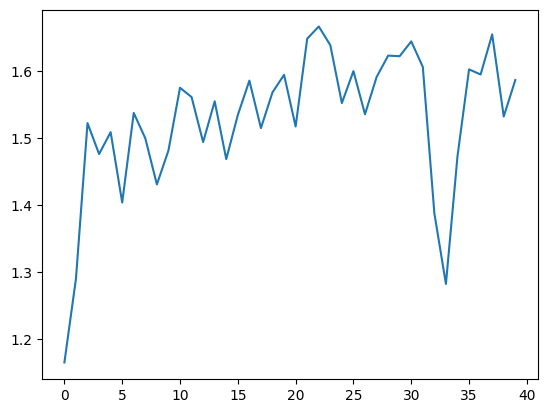

In [36]:
plt.plot(yy,l2_loss)
plt.show()

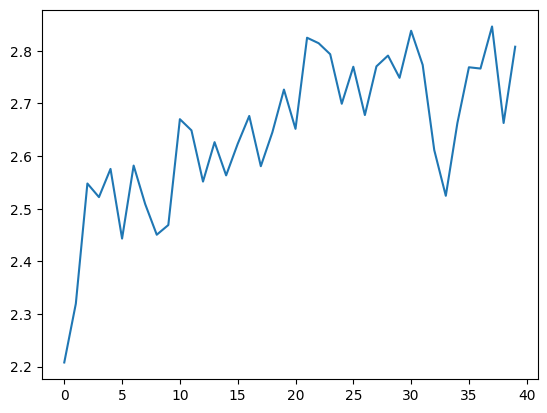

In [37]:
plt.plot(yy,total_cycle_loss_loss)
plt.show()